In [156]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib.style as style 
style.use('fivethirtyeight')
style.use('bmh')
pd.set_option('display.max_colwidth', None)

In [3]:
#Load data; specifically pre-made training dataset that has already been grouped by rater-agreement from 
# GoEmotions dataset
df_train = pd.read_csv('/Users/subikshc/Documents/Code/Springboard Course/Capstone 3/archive (14)/data/train.tsv',
                       sep ='\t',header = None, names = ['text','label','id'])

In [8]:
df_train.head()

,text,label,id
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj
3,To make her feel threatened,14,ed7ypvh
4,Dirty Southern Wankers,3,ed0bdzj


In [11]:
#Labels are stored as string of numbers
df_train.label.value_counts(5)

27           0.295393
0            0.062428
4            0.043147
15           0.042778
1            0.038056
               ...   
6,15,22      0.000023
9,10,19      0.000023
7,10,25      0.000023
7,9,24,25    0.000023
0,1,18       0.000023
Name: label, Length: 711, dtype: float64

In [5]:
df_train.label.info()

<class 'pandas.core.series.Series'>
RangeIndex: 43410 entries, 0 to 43409
Series name: label
Non-Null Count  Dtype 
--------------  ----- 
43410 non-null  object
dtypes: object(1)
memory usage: 339.3+ KB


In [17]:
#Create new columns to split up labels list into list of label numbers

df_train['labels_list'] = df_train['label'].apply(lambda x: x.split(','))
df_train['labels_len'] = df_train['labels_list'].apply(lambda x: len(x))

In [18]:
df_train['labels_len'].describe()

count    43410.000000
mean         1.177217
std          0.417699
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max          5.000000
Name: labels_len, dtype: float64

In [19]:
df_train

,text,label,id,labels_list,labels_len
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej,[27],1
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i,[27],1
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],1
3,To make her feel threatened,14,ed7ypvh,[14],1
4,Dirty Southern Wankers,3,ed0bdzj,[3],1
...,...,...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,edsb738,[18],1
43406,Always thought that was funny but is it a reference to anything?,6,ee7fdou,[6],1
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,efgbhks,[3],1
43408,"More like a baptism, with sexy results!",13,ed1naf8,[13],1


In [20]:
#No null rows
df_train.isnull().sum()

text           0
label          0
id             0
labels_list    0
labels_len     0
dtype: int64

In [21]:
df_train.labels_list.value_counts()

[27]              12823
[0]                2710
[4]                1873
[15]               1857
[1]                1652
                  ...  
[6, 15, 22]           1
[9, 10, 19]           1
[7, 10, 25]           1
[7, 9, 24, 25]        1
[0, 1, 18]            1
Name: labels_list, Length: 711, dtype: int64

<Axes: >

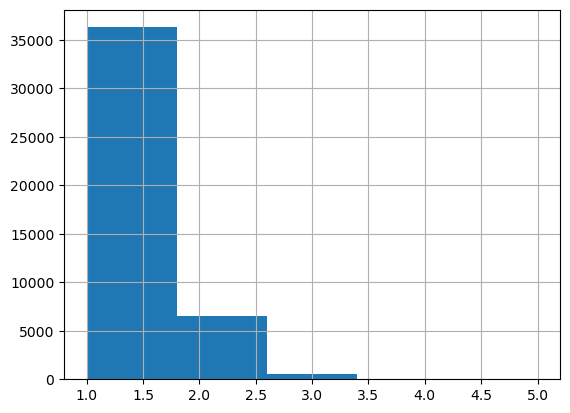

In [22]:
df_train.labels_len.hist(bins = 5)

In [23]:
df_train.labels_len.value_counts(normalize = True)

1    0.836397
2    0.150680
3    0.012255
4    0.000645
5    0.000023
Name: labels_len, dtype: float64

In [24]:
df_train[df_train.labels_len == 2].labels_list.value_counts()[0:10]

[2, 3]      230
[0, 15]     227
[0, 4]      199
[4, 27]     190
[6, 7]      174
[0, 18]     155
[3, 10]     148
[3, 27]     123
[10, 27]    104
[9, 25]     103
Name: labels_list, dtype: int64

In [25]:
#Create dictionary of emotions to map numeric labels to 

emotions = {
0:'admiration',
1:'amusement',
2:'anger',
3:'annoyance',
4:'approval',
5:'caring',
6:'confusion',
7:'curiosity',
8:'desire',
9:'disappointment',
10:'disapproval',
11:'disgust',
12:'embarrassment',
13:'excitement',
14:'fear',
15:'gratitude',
16:'grief',
17:'joy',
18:'love',
19:'nervousness',
20:'optimism',
21:'pride',
22:'realization',
23:'relief',
24:'remorse',
25:'sadness',
26:'surprise',
27:'neutral'}
emotions

{0: 'admiration',
 1: 'amusement',
 2: 'anger',
 3: 'annoyance',
 4: 'approval',
 5: 'caring',
 6: 'confusion',
 7: 'curiosity',
 8: 'desire',
 9: 'disappointment',
 10: 'disapproval',
 11: 'disgust',
 12: 'embarrassment',
 13: 'excitement',
 14: 'fear',
 15: 'gratitude',
 16: 'grief',
 17: 'joy',
 18: 'love',
 19: 'nervousness',
 20: 'optimism',
 21: 'pride',
 22: 'realization',
 23: 'relief',
 24: 'remorse',
 25: 'sadness',
 26: 'surprise',
 27: 'neutral'}

In [26]:
def id2emotions(lst):
    #Function to map label numbers into their corresponding emotions
    
    emotions_lst = []
    for i in lst:
        emotions_lst.append(emotions[int(i)])
    return emotions_lst

In [27]:
#Create new column with mapped emotions
df_train['emotions_list'] = df_train['labels_list'].apply(id2emotions)

In [28]:
#Ensure all values in labels list are ints
df_train['labels_list'] = df_train['labels_list'].apply(lambda lst: list(map(int, lst)))

In [29]:
#Use one-hot encoding to create new columns for each emotion
for i in emotions:
    df_train[emotions[i]] = df_train['labels_list'].apply(lambda x: 1 if i in x else 0)

In [30]:
df_train['emotions_list'].value_counts()

[neutral]                                        12823
[admiration]                                      2710
[approval]                                        1873
[gratitude]                                       1857
[amusement]                                       1652
                                                 ...  
[confusion, gratitude, realization]                  1
[disappointment, disapproval, nervousness]           1
[curiosity, disapproval, sadness]                    1
[curiosity, disappointment, remorse, sadness]        1
[admiration, amusement, love]                        1
Name: emotions_list, Length: 711, dtype: int64

In [32]:
df_train

,text,label,id,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
0,My favourite food is anything I didn't have to cook myself.,27,eebbqej,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,ed00q6i,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,WHY THE FUCK IS BAYLESS ISOING,2,eezlygj,[2],1,[anger],0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,To make her feel threatened,14,ed7ypvh,[14],1,[fear],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Dirty Southern Wankers,3,ed0bdzj,[3],1,[annoyance],0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,edsb738,[18],1,[love],0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
43406,Always thought that was funny but is it a reference to anything?,6,ee7fdou,[6],1,[confusion],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,efgbhks,[3],1,[annoyance],0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
43408,"More like a baptism, with sexy results!",13,ed1naf8,[13],1,[excitement],0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [33]:
#Import NLP packages

import spacy
import nltk
nltk.download('wordnet')
from nltk.corpus import stopwords
from nltk.tokenize.toktok import ToktokTokenizer
import re
from bs4 import BeautifulSoup
from contractions import CONTRACTION_MAP
from nltk.stem import WordNetLemmatizer
import unicodedata
import en_core_web_sm
nlp = en_core_web_sm.load()
#nlp_vec = spacy.load('en_vecs', parse = True, tag=True, #entity=True)
tokenizer = ToktokTokenizer()
stopword_list = nltk.corpus.stopwords.words('english')
stopword_list.remove('no')
stopword_list.remove('not')

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/subikshc/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [34]:
#Import dictionary of contractions for NLP
contraction_mapping = {"ain't": "is not", "aren't": "are not","can't": "cannot", "'cause": "because", "could've": "could have", "couldn't": "could not", 
                       "didn't": "did not",  "doesn't": "does not", "don't": "do not", "hadn't": "had not", "hasn't": "has not", "haven't": "have not", 
                       "he'd": "he would","he'll": "he will", "he's": "he is", "how'd": "how did", "how'd'y": "how do you", "how'll": "how will", 
                       "how's": "how is",  "I'd": "I would", "I'd've": "I would have", "I'll": "I will", "I'll've": "I will have","I'm": "I am",
                       "I've": "I have", "i'd": "i would", "i'd've": "i would have", "i'll": "i will",  "i'll've": "i will have","i'm": "i am", 
                       "i've": "i have", "isn't": "is not", "it'd": "it would", "it'd've": "it would have", "it'll": "it will", "it'll've": "it will have",
                       "it's": "it is", "let's": "let us", "ma'am": "madam", "mayn't": "may not", "might've": "might have","mightn't": "might not",
                       "mightn't've": "might not have", "must've": "must have", "mustn't": "must not", "mustn't've": "must not have", "needn't": "need not", 
                       "needn't've": "need not have","o'clock": "of the clock", "oughtn't": "ought not", "oughtn't've": "ought not have", "shan't": "shall not",
                       "sha'n't": "shall not", "shan't've": "shall not have", "she'd": "she would", "she'd've": "she would have", "she'll": "she will", 
                       "she'll've": "she will have", "she's": "she is", "should've": "should have", "shouldn't": "should not", "shouldn't've": "should not have",
                       "so've": "so have","so's": "so as", "this's": "this is","that'd": "that would", "that'd've": "that would have", "that's": "that is",
                       "there'd": "there would", "there'd've": "there would have", "there's": "there is", "here's": "here is","they'd": "they would",
                       "they'd've": "they would have", "they'll": "they will", "they'll've": "they will have", "they're": "they are", "they've": "they have",
                       "to've": "to have", "wasn't": "was not", "we'd": "we would", "we'd've": "we would have", "we'll": "we will", "we'll've": "we will have",
                       "we're": "we are", "we've": "we have", "weren't": "were not", "what'll": "what will", "what'll've": "what will have", 
                       "what're": "what are",  "what's": "what is", "what've": "what have", "when's": "when is", "when've": "when have", "where'd": "where did",
                       "where's": "where is", "where've": "where have", "who'll": "who will", "who'll've": "who will have", "who's": "who is", 
                       "who've": "who have", "why's": "why is", "why've": "why have", "will've": "will have", "won't": "will not", "won't've": "will not have", 
                       "would've": "would have", "wouldn't": "would not", "wouldn't've": "would not have", "y'all": "you all", "y'all'd": "you all would",
                       "y'all'd've": "you all would have","y'all're": "you all are","y'all've": "you all have","you'd": "you would", "you'd've": "you would have",
                       "you'll": "you will", "you'll've": "you will have", "you're": "you are", "you've": "you have", 'u.s':'america', 'e.g':'for example'}



In [35]:
#Import other dictionaries for NLP 

punct = [',', '.', '"', ':', ')', '(', '-', '!', '?', '|', ';', "'", '$', '&', '/', '[', ']', '>', '%', '=', '#', '*', '+', '\\', '•',  '~', '@', '£', 
 '·', '_', '{', '}', '©', '^', '®', '`',  '<', '→', '°', '€', '™', '›',  '♥', '←', '×', '§', '″', '′', 'Â', '█', '½', 'à', '…', 
 '“', '★', '”', '–', '●', 'â', '►', '−', '¢', '²', '¬', '░', '¶', '↑', '±', '¿', '▾', '═', '¦', '║', '―', '¥', '▓', '—', '‹', '─', 
 '▒', '：', '¼', '⊕', '▼', '▪', '†', '■', '’', '▀', '¨', '▄', '♫', '☆', 'é', '¯', '♦', '¤', '▲', 'è', '¸', '¾', 'Ã', '⋅', '‘', '∞', 
 '∙', '）', '↓', '、', '│', '（', '»', '，', '♪', '╩', '╚', '³', '・', '╦', '╣', '╔', '╗', '▬', '❤', 'ï', 'Ø', '¹', '≤', '‡', '√', ]

punct_mapping = {"‘": "'", "₹": "e", "´": "'", "°": "", "€": "e", "™": "tm", "√": " sqrt ", "×": "x", "²": "2", "—": "-", "–": "-", "’": "'", "_": "-",
                 "`": "'", '“': '"', '”': '"', '“': '"', "£": "e", '∞': 'infinity', 'θ': 'theta', '÷': '/', 'α': 'alpha', '•': '.', 'à': 'a', '−': '-', 
                 'β': 'beta', '∅': '', '³': '3', 'π': 'pi', '!':' '}

mispell_dict = {'colour': 'color', 'centre': 'center', 'favourite': 'favorite', 'travelling': 'traveling', 'counselling': 'counseling', 'theatre': 'theater',
                'cancelled': 'canceled', 'labour': 'labor', 'organisation': 'organization', 'wwii': 'world war 2', 'citicise': 'criticize', 'youtu ': 'youtube ',
                'Qoura': 'Quora', 'sallary': 'salary', 'Whta': 'What', 'narcisist': 'narcissist', 'howdo': 'how do', 'whatare': 'what are', 'howcan': 'how can',
                'howmuch': 'how much', 'howmany': 'how many', 'whydo': 'why do', 'doI': 'do I', 'theBest': 'the best', 'howdoes': 'how does', 
                'mastrubation': 'masturbation', 'mastrubate': 'masturbate', "mastrubating": 'masturbating', 'pennis': 'penis', 'Etherium': 'Ethereum', 
                'narcissit': 'narcissist', 'bigdata': 'big data', '2k17': '2017', '2k18': '2018', 'qouta': 'quota', 'exboyfriend': 'ex boyfriend', 
                'airhostess': 'air hostess', "whst": 'what', 'watsapp': 'whatsapp', 'demonitisation': 'demonetization', 'demonitization': 'demonetization',
                'demonetisation': 'demonetization'}

In [36]:
def remove_accented_chars(text):
    #Removes accented characters from text to make uniform
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
    return text

remove_accented_chars('Sómě Áccěntěd těxt')

'Some Accented text'

In [37]:
def expand_contractions(text, contraction_mapping=CONTRACTION_MAP):
    #Exapnds contractions in text to make uniform
    
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())), 
                                      flags=re.IGNORECASE|re.DOTALL)
    def expand_match(contraction):
        match = contraction.group(0)
        first_char = match[0]
        expanded_contraction = contraction_mapping.get(match)\
                                if contraction_mapping.get(match)\
                                else contraction_mapping.get(match.lower())                       
        expanded_contraction = first_char+expanded_contraction[1:]
        return expanded_contraction
        
    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
    return expanded_text

expand_contractions("Y'all can't expand contractions I'd think")

'You all cannot expand contractions I would think'

In [38]:
def remove_special_characters(text, remove_digits=False):
    #Removes special characters from text to make uniform
    pattern = r'[^a-zA-z0-9\s]' if not remove_digits else r'[^a-zA-z\s]'
    text = re.sub(pattern, '', text)
    return text

remove_special_characters("Well this was fun! What do you think? 123#@!", 
                          remove_digits=True)

'Well this was fun What do you think '

In [39]:
def lemmatize_text(text):
    #Lemmatize text into roots for NLP
    text = nlp(text)
    text = ' '.join([word.lemma_ if word.lemma_ != '-PRON-' else word.text for word in text])
    return text

lemmatize_text("My system keeps crashing! his crashed yesterday, ours crashes daily")

'my system keep crash ! his crashed yesterday , ours crash daily'

In [40]:
def remove_stopwords(text, is_lower_case=False):
    #Remove stopwords (non-essential to meaning) for NLP 
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stopword_list]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stopword_list]
    filtered_text = ' '.join(filtered_tokens)    
    return filtered_text

remove_stopwords("The, and, if are stopwords, computer is not")

', , stopwords , computer not'

In [41]:
lm = WordNetLemmatizer()

In [42]:
def text_processor(col):
    #Function that combines diffferent NLP steps into one process
    corpus = []
    for item in col:
        new_item = re.sub('[^a-zA-Z]',' ',str(item))
        new_item = remove_accented_chars(new_item)
        new_item = expand_contractions(new_item)
        new_item = remove_special_characters(new_item)
        new_item = new_item.lower()
        new_item = new_item.split()
        new_item = [lm.lemmatize(word) for word in new_item if word not in set(stopword_list)]
        corpus.append(' '.join(str(x) for x in new_item))
    return corpus

In [43]:
texts = ['this is a preetty cool test sentience','Do you SEE THESE IN CAPS??',"we can't all do this ain't it great"]
text_processor(texts)

['preetty cool test sentience', 'see cap', 'great']

In [44]:
corpus = text_processor(df_train['text'])

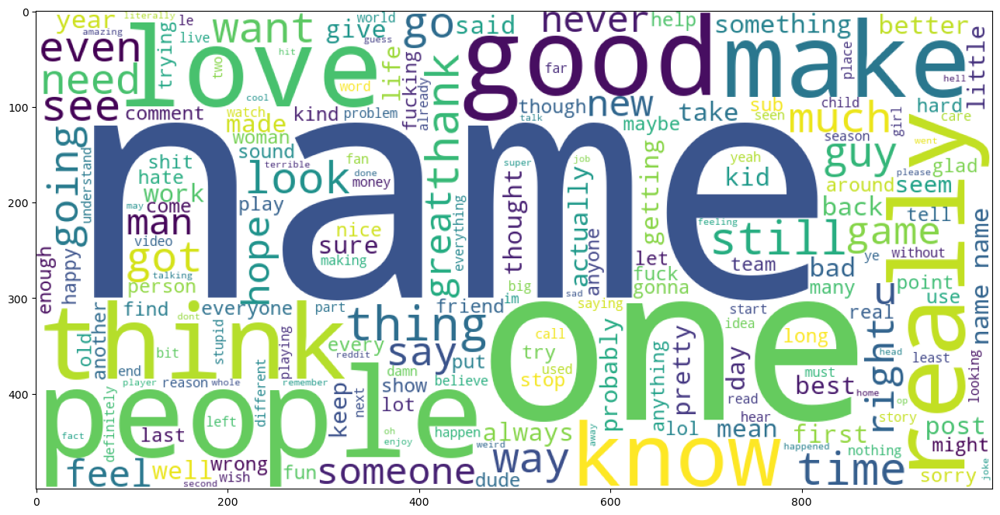

In [45]:
#Word Cloud to see common words
from wordcloud import WordCloud

plt.figure(figsize = (20,8))
word_cloud = ""
for row in corpus:
    for word in row:
        word_cloud+=" ".join(word)
wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(word_cloud)
plt.imshow(wordcloud)

*Shows 'name' as very common word

In [46]:
df_train[df_train.text.str.contains('name')]

,text,label,id,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
24,His name has already been released. Just can't post it here.,27,ee18uaj,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
103,"[NAME] was useless, aside from bandaging [NAME] up a bit more than she already did and treating [NAME], name one decision [NAME] has made smartly.",27,eeapczm,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
129,Tournament was a blast met some really cool people loved it all. Thanks for holding it. Would love to do it again someday,"0,8,15,17",edycw66,"[0, 8, 15, 17]",4,"[admiration, desire, gratitude, joy]",1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
412,Change the initials to fake names. Was going to read but it’s too annoying.,"3,22",edut32r,"[3, 22]",2,"[annoyance, realization]",0,0,0,1,...,0,0,0,0,1,0,0,0,0,0
694,Because majority of moves have stupidly long names. GO INTO ANGEL PUNISHER INTO DIVE BOMB RADIANCE AND FINISH THE JOB WITH PUNISHING LIGHT BLADE,2,eetcmd6,[2],1,[anger],0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43004,Have a look at the decks from the latest weplay tournament and if there’s anything you like the look of.,27,ef7uihl,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
43005,Hello please repost with names censored. :) <3 xoxo hugs and disco kisses,27,edwkato,[27],1,[neutral],0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
43039,Such a lovely username for such a nice guy,0,edvrv7m,[0],1,[admiration],1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
43150,"The name he asked if I was, was some foreign name. It was so far off from my actual name I thought it was a joke at first",22,eehdg3g,[22],1,[realization],0,0,0,0,...,0,0,0,0,1,0,0,0,0,0


*'[NAME]' is used to anonymize the text in this dataset; this is not useful for NLP process and can be removed

In [47]:
#Add 'name' to list of stopwords so it is removed from text
stopword_list.append('name')

In [48]:
#Create new column with nlp processed text 
df_train['clean_text'] =  text_processor(df_train['text'])

In [49]:
#Create a filter to work with rows that are only labeled with a single emotion to look at each emotion
df_single_emotion = df_train[df_train['labels_len'] == 1]

In [50]:
df_train['clean_text'] = df_train['clean_text'].astype(str)

In [51]:
#Create a dictionary where each emotion is a key and its value is the sum of all text labeled as this emotion
emotions_text = {}
for e in emotions:
    emotion = emotions.get(e)
    
    emotions_text[emotion] = df_single_emotion[df_single_emotion[emotion] > 0]['clean_text'].sum()
    
    

In [54]:
#Compare filter to dictionary to see they gave same result of text related to 'anger'
emotion = emotions.get(2)
df_single_emotion[df_single_emotion[emotion] > 0]['clean_text'].sum()

'fuck bayless isoingfucking cowardstupidly stubborn stubbornly stupidtroll bro know saying stupid shit motherfucker nothing stink libertarian sub talking shitfuck mogespecially australia gonna cop ad tv god hatekill scumtold pointless point idiotfuck backgroundfucking please nosupporter dumbest human fucking galaxy locked safetyok know suck scrubforce someone come know look killed bastardya hate talk bad get stick butt make smarter decision communitycomment like biggest reason get pissed fucking centrist cry side argumentfuck atheist countryjob job know hardware store make ppl stupid hell stupidmajority move stupidly long name go angel punisher dive bomb radiance finish job punishing light bladesaid hated dont give damn either wayfucking starvingeat fuckfire medical teamugh sound like slob leavekilling timefucking boyfuck white house fuck mcdonald fuck postbitch yesexceedingly rare failure read article guy stupid stoppedhell talkingranting aimlessly internet obviouslyive seen move no l

In [55]:
emotions_text['anger']

'fuck bayless isoingfucking cowardstupidly stubborn stubbornly stupidtroll bro know saying stupid shit motherfucker nothing stink libertarian sub talking shitfuck mogespecially australia gonna cop ad tv god hatekill scumtold pointless point idiotfuck backgroundfucking please nosupporter dumbest human fucking galaxy locked safetyok know suck scrubforce someone come know look killed bastardya hate talk bad get stick butt make smarter decision communitycomment like biggest reason get pissed fucking centrist cry side argumentfuck atheist countryjob job know hardware store make ppl stupid hell stupidmajority move stupidly long name go angel punisher dive bomb radiance finish job punishing light bladesaid hated dont give damn either wayfucking starvingeat fuckfire medical teamugh sound like slob leavekilling timefucking boyfuck white house fuck mcdonald fuck postbitch yesexceedingly rare failure read article guy stupid stoppedhell talkingranting aimlessly internet obviouslyive seen move no l

Text appears to match 

In [56]:
def wordcloud_maker(name,lst):
    #Function to create a Word Cloud as 'name' given a list containing text
    
    plt.figure(figsize = (20,8))
    word_cloud = ""
    
    for word in lst:
        word_cloud+=" ".join(word)
    wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(word_cloud)
    plt.title(f"Wordcloud for {name}")
    plt.imshow(wordcloud)


/var/folders/b6/_m6td1sj1gx6y7djysg9kvjr0000gn/T/ipykernel_92461/4189886684.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (20,8))


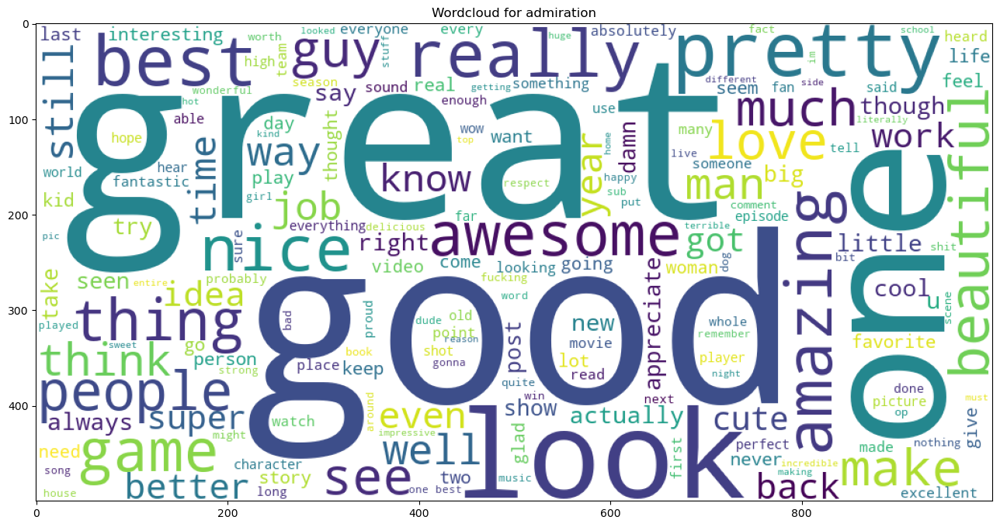

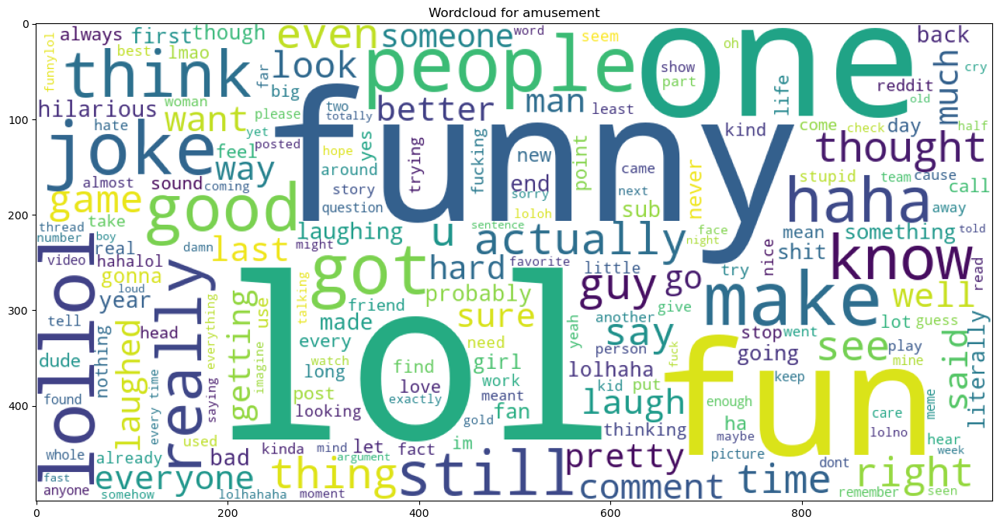

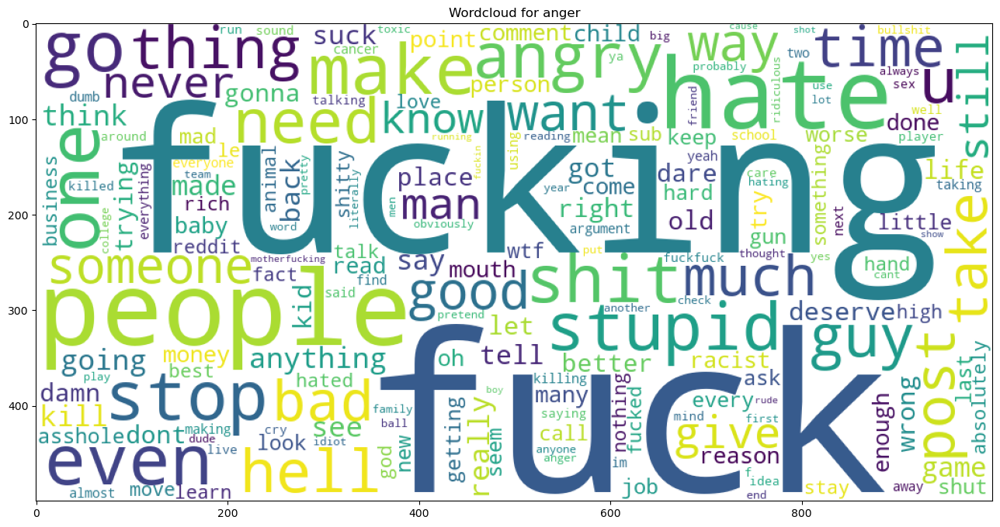

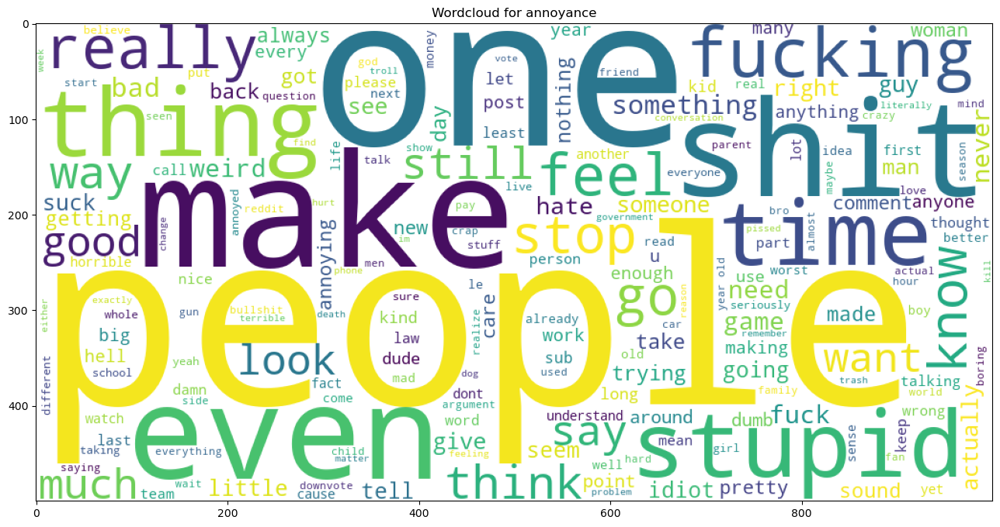

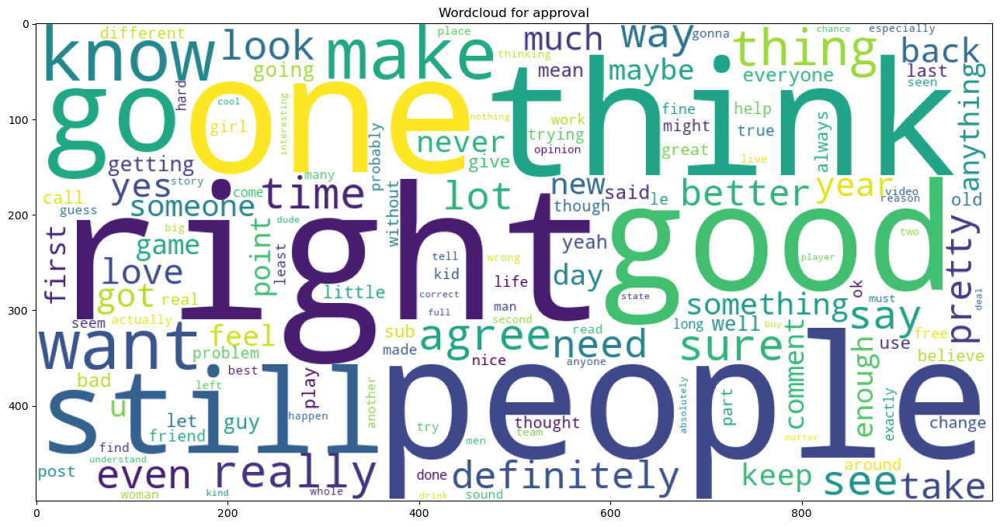

...

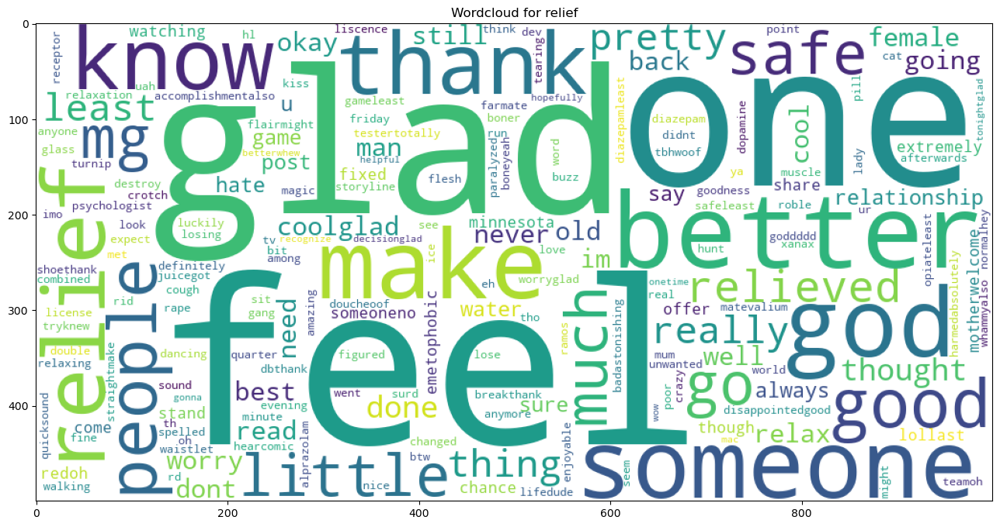

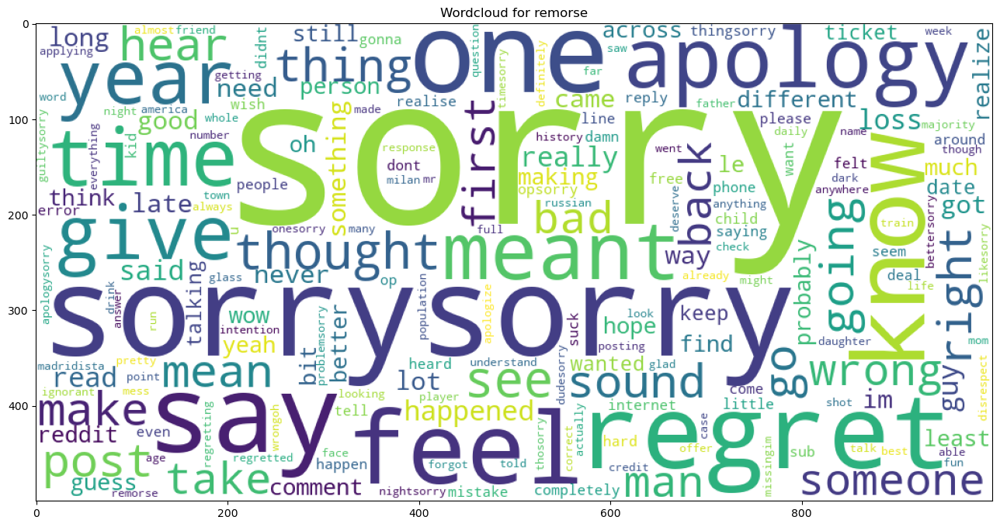

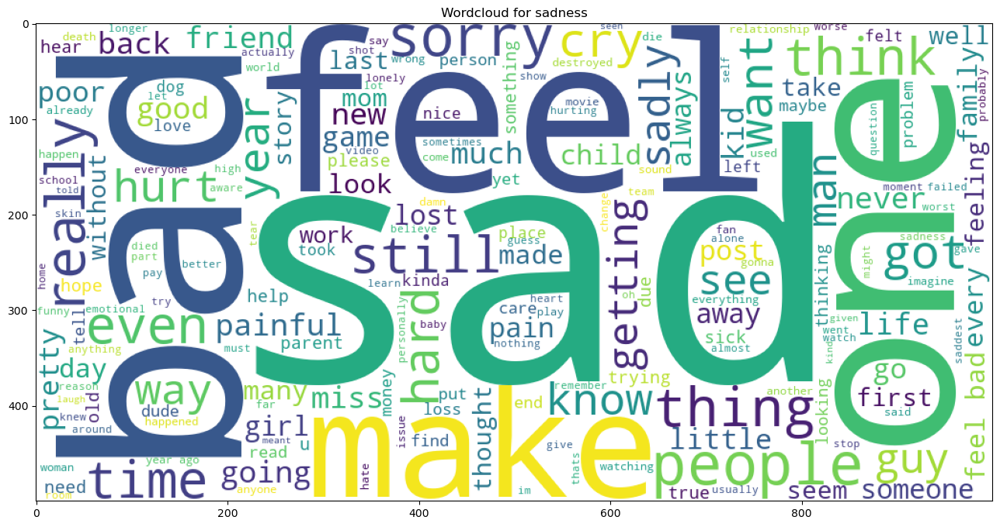

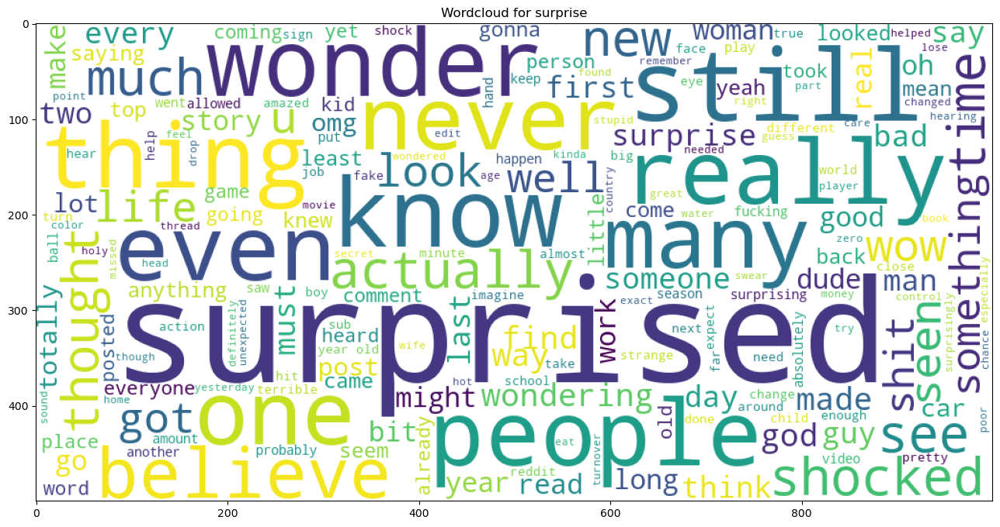

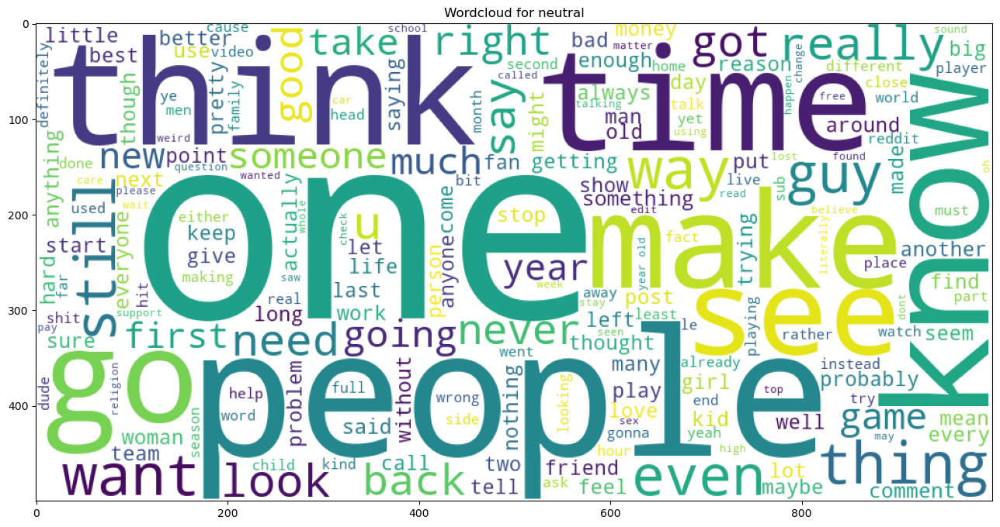

In [57]:
#Create a Word Cloud for each emotion to see common words associated to each emotion

for e in emotions_text:
    wordcloud_maker(e,emotions_text[e])

In [60]:
df_train.describe()

,labels_len,admiration,amusement,anger,annoyance,approval,caring,confusion,curiosity,desire,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
count,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,...,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000,43410.000000
mean,1.177217,0.095139,0.053628,0.036098,0.056899,0.067703,0.025040,0.031513,0.050472,0.014766,...,0.048053,0.003778,0.036420,0.002557,0.025570,0.003525,0.012555,0.030546,0.024418,0.327551
std,0.417699,0.293411,0.225285,0.186535,0.231653,0.251239,0.156249,0.174703,0.218920,0.120617,...,0.213882,0.061349,0.187335,0.050503,0.157851,0.059264,0.111344,0.172086,0.154346,0.469326
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [62]:
#Filter to only get the numberic columns from df_train
num_cols = df_train.select_dtypes(int)

#Sum one hot encoded columns to get sum number of examples of each emotion
num_cols.sum().sort_values(ascending = False)

labels_len        51103
neutral           14219
admiration         4130
approval           2939
gratitude          2662
annoyance          2470
amusement          2328
curiosity          2191
love               2086
disapproval        2022
optimism           1581
anger              1567
joy                1452
confusion          1368
sadness            1326
disappointment     1269
realization        1110
caring             1087
surprise           1060
excitement          853
disgust             793
desire              641
fear                596
remorse             545
embarrassment       303
nervousness         164
relief              153
pride               111
grief                77
dtype: int64

In [63]:
num_cols.drop('labels_len',axis = 1,inplace = True)

In [64]:
num_cols_sum = num_cols.sum().sort_values(ascending = False)

In [65]:
num_cols.sum().sort_values(ascending = False)

neutral           14219
admiration         4130
approval           2939
gratitude          2662
annoyance          2470
amusement          2328
curiosity          2191
love               2086
disapproval        2022
optimism           1581
anger              1567
joy                1452
confusion          1368
sadness            1326
disappointment     1269
realization        1110
caring             1087
surprise           1060
excitement          853
disgust             793
desire              641
fear                596
remorse             545
embarrassment       303
nervousness         164
relief              153
pride               111
grief                77
dtype: int64

In [161]:
#Create lists to seperate positive vs. negative vs. ambiguous emotions

pos_emotions = ['admiration','amusement','approval','caring','desire','excitement','gratitude','joy','love',
               'optimism','pride','relief']
neg_emotions = ['anger','annoyance','disappointment','disapproval','disgust','embarrassment','fear','grief',
               'nervousness','remorse','sadness']
ambig_emotions = ['confusion','curiosity','realization','surprise','neutral']

In [67]:
def map2type (emotion):
    #Function to map current emotion into corresponding type of emotion
    if emotion in pos_emotions:
        return 'Positive'
    elif emotion in neg_emotions:
        return 'Negative'
    elif emotion in ambig_emotions:
        return 'Ambiguous'

In [68]:
num_cols_sum = pd.DataFrame(num_cols_sum)
num_cols_sum.reset_index(inplace = True)


In [69]:
num_cols_sum.columns = ['emotion','examples']
num_cols_sum

,emotion,examples
0,neutral,14219
1,admiration,4130
2,approval,2939
3,gratitude,2662
4,annoyance,2470
5,amusement,2328
6,curiosity,2191
7,love,2086
8,disapproval,2022
9,optimism,1581


In [70]:
#Create new column for type of emotion
num_cols_sum['type'] = num_cols_sum.emotion.apply(map2type)

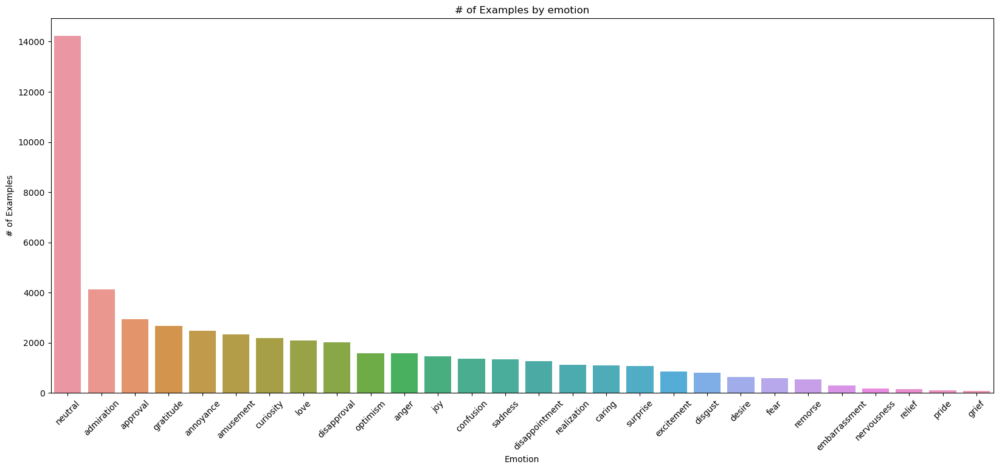

In [73]:
#Create plot of emotions by number of examples in dataset

plt.figure(figsize = (20,8))
sns.barplot(data = num_cols_sum, x = 'emotion',y ='examples')
plt.xticks(rotation=45)
plt.title('# of Examples by emotion')
plt.ylabel('# of Examples')
plt.xlabel('Emotion')
plt.show()


Most examples are labeled as neutral

In [74]:
#Create mask to see non-neutral emotions
num_cols_sum_no_neutral = num_cols_sum[num_cols_sum['emotion'] != 'neutral']
num_cols_sum_no_neutral

,emotion,examples,type
1,admiration,4130,Positive
2,approval,2939,Positive
3,gratitude,2662,Positive
4,annoyance,2470,Negative
5,amusement,2328,Positive
6,curiosity,2191,Ambiguous
7,love,2086,Positive
8,disapproval,2022,Negative
9,optimism,1581,Positive
10,anger,1567,Negative


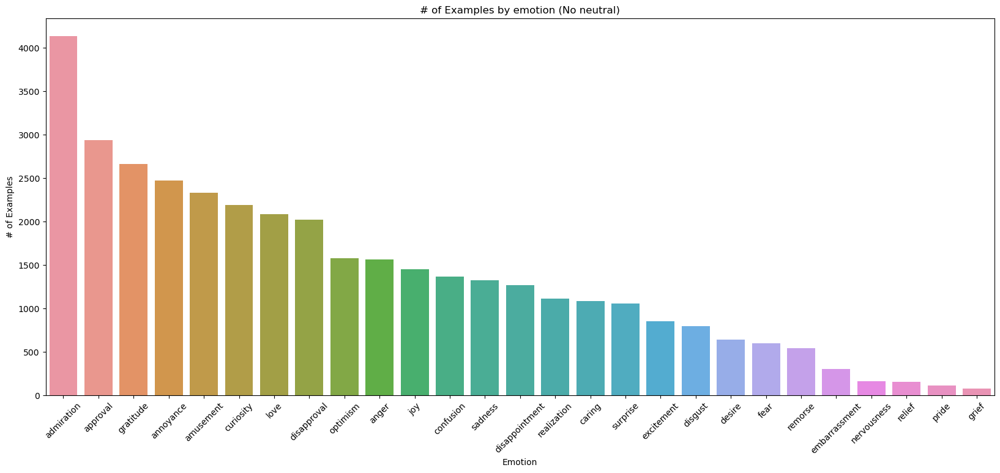

In [77]:
#Make similar plot of emotions vs. number of examples without neutral

plt.figure(figsize = (20,8))
sns.barplot(data = num_cols_sum_no_neutral, x = 'emotion',y ='examples')
plt.xticks(rotation=45)
plt.title('# of Examples by emotion (No neutral)')
plt.ylabel('# of Examples')
plt.xlabel('Emotion')
plt.show()

Unequal number of examples of labeled emotions

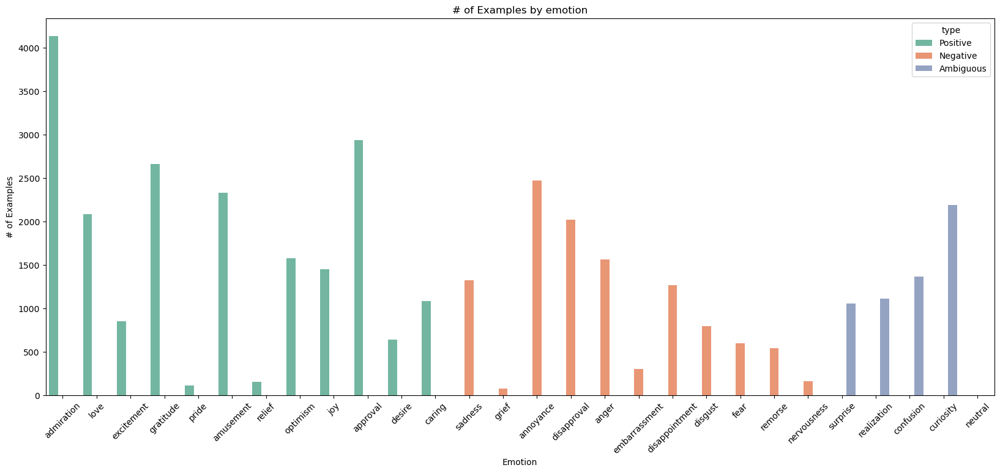

In [146]:
#Create plot color-coded by types of emotion (positive vs. negative vs. ambiguous)


plt.figure(figsize = (20,8))
sns.barplot(data = num_cols_sum.sort_values('type',ascending = False), x = 'emotion',y ='examples',hue = 'type',palette = 'Set2')
plt.xticks(rotation=45)
plt.title('# of Examples by emotion')
plt.ylabel('# of Examples')
plt.xlabel('Emotion')
plt.show()


Appears there are more examples of positive emotions in data set

In [85]:
df_train.id.value_counts()

#No duplicated values in id; this column does not provide any value and can be dropped

eebbqej    1
eeoaj00    1
ed45gu1    1
edvjn6g    1
ef0cb3j    1
          ..
edbs9ek    1
edqkwhe    1
ee69cp2    1
eeua5h0    1
eecwmbq    1
Name: id, Length: 43410, dtype: int64

In [87]:
df_train.drop('id',axis = 1,inplace = True)
df_train

,text,label,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,approval,...,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral,clean_text
0,My favourite food is anything I didn't have to cook myself.,27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,favourite food anything cook
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,everyone think he laugh screwing people instead actually dead
2,WHY THE FUCK IS BAYLESS ISOING,2,[2],1,[anger],0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,fuck bayless isoing
3,To make her feel threatened,14,[14],1,[fear],0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,make feel threatened
4,Dirty Southern Wankers,3,[3],1,[annoyance],0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,dirty southern wanker
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43405,Added you mate well I’ve just got the bow and I love the hunting aspect of the game so happily join you hunting and what not,18,[18],1,[love],0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,added mate well got bow love hunting aspect game happily join hunting not
43406,Always thought that was funny but is it a reference to anything?,6,[6],1,[confusion],0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,always thought funny reference anything
43407,What are you talking about? Anything bad that happened was [NAME] fault - only good things were [NAME] doing!,3,[3],1,[annoyance],0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,talking anything bad happened fault good thing
43408,"More like a baptism, with sexy results!",13,[13],1,[excitement],0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,like baptism sexy result


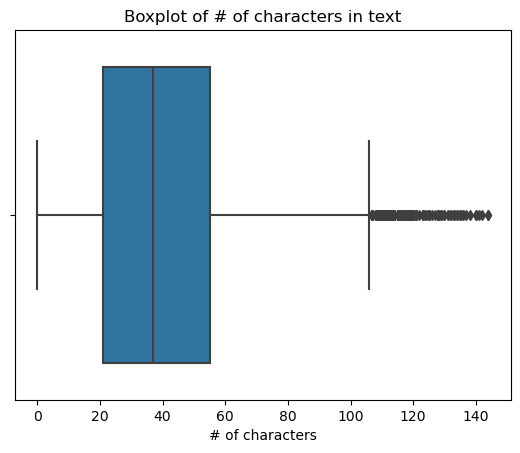

In [97]:
#Boxplot to see length of texts
sns.boxplot(data=df_train, x=df_train['clean_text'].str.len())
plt.title('Boxplot of # of characters in text')
plt.xlabel('# of characters')
plt.show()

Appear to be some outliers with very long texts

In [90]:
df_train[df_train['clean_text'].str.len() > 150]

,text,label,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,approval,...,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral,clean_text
28640,No the whippet sound is WUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUBWUB And then you need another balloon. Spot on with the gunshot though. Just like intense temporary tinnitus.,27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,no whippet sound wubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwubwub need another balloon spot gunshot though like intense temporary tinnitus
28694,here you go: |Games|Home|Away|Team|vs W-L 18-19| |:-|:-|:-|:-|-:| |1|1|0|Golden State|0-1| |2|1|1|Houston|0-0| |2|1|1|Oklahoma City|0-0| |2|0|2|Toronto|1-1| |2|1|1|Milwaukee|0-1| |3|1|2|Indiana|0-1| |2|1|1|Philadelphia|1-1| |2|1|1|Boston|1-0| |1|1|0|Minnesota|0-1| |2|1|1|New Orleans|0-0| |2|1|1|Memphis|0-0| |1|1|0|Dallas|0-1| |1|0|1|Miami|2-1| |3|2|1|Brooklyn|0-0| |2|1|1|Charlotte|0-2| |2|0|2|Detroit|1-1| |2|1|1|Washington|1-1| |2|1|1|New York|2-0| |2|1|1|Cleveland|1-0| |4|2|2|Atlanta|0-0| |1|1|0|Chicago|2-1|,27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,go game home away team v w l golden state houston oklahoma city toronto milwaukee indiana philadelphia boston minnesota new orleans memphis dallas miami brooklyn charlotte detroit washington new york cleveland atlanta chicago
32595,Macaroni and cheese Beans Bacon Grits Hash browns Maple syrup Imported Tim's coffee Poutine Hawaiian pizza Beaver tail Ketchup and all dressed chips Nanaimo bars Whiskey Craft beer,27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,macaroni cheese bean bacon grit hash brown maple syrup imported tim coffee poutine hawaiian pizza beaver tail ketchup dressed chip nanaimo bar whiskey craft beer
35488,"Communism naturally results in dictatorship. When you centralize power, you invite the power-hungry. Every morally-motivated communist seems to think they're immune to the bullets of power-hungry totalitarians.",27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,communism naturally result dictatorship centralize power invite power hungry every morally motivated communist seems think immune bullet power hungry totalitarian


These texts mostly appear to be nonsen and are all coded as 'Neutral' so will drop them from dataset

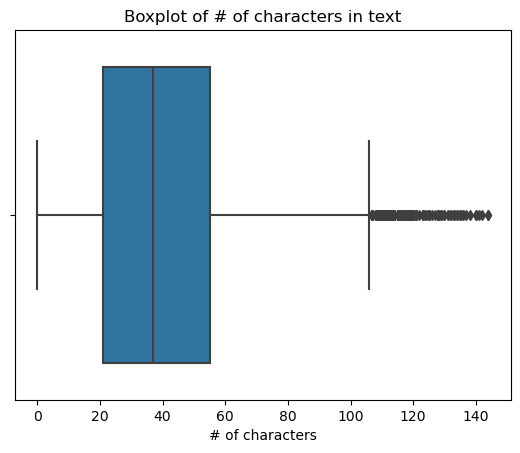

In [98]:
df_train = df_train[df_train['clean_text'].str.len() <= 150]
#Boxplot to see length of texts
sns.boxplot(data=df_train, x=df_train['clean_text'].str.len())
plt.title('Boxplot of # of characters in text')
plt.xlabel('# of characters')
plt.show()

In [123]:
#Create new column with length of characters
df_train['text_length'] = df_train['clean_text'].str.len()

In [185]:
df_single_emotion = df_train[df_train['labels_len'] == 1]
df_single_emotion.head()

,text,label,labels_list,labels_len,emotions_list,admiration,amusement,anger,annoyance,approval,...,pride,realization,relief,remorse,sadness,surprise,neutral,clean_text,len_chars,text_length
0,My favourite food is anything I didn't have to cook myself.,27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,1,favourite food anything cook,28,28
1,"Now if he does off himself, everyone will think hes having a laugh screwing with people instead of actually dead",27,[27],1,[neutral],0,0,0,0,0,...,0,0,0,0,0,0,1,everyone think he laugh screwing people instead actually dead,61,61
2,WHY THE FUCK IS BAYLESS ISOING,2,[2],1,[anger],0,0,1,0,0,...,0,0,0,0,0,0,0,fuck bayless isoing,19,19
3,To make her feel threatened,14,[14],1,[fear],0,0,0,0,0,...,0,0,0,0,0,0,0,make feel threatened,20,20
4,Dirty Southern Wankers,3,[3],1,[annoyance],0,0,0,1,0,...,0,0,0,0,0,0,0,dirty southern wanker,21,21


In [186]:
#Extract emotion from list of emotions for easier access
df_single_emotion['emotion'] = df_single_emotion.emotions_list.str[0]

/var/folders/b6/_m6td1sj1gx6y7djysg9kvjr0000gn/T/ipykernel_92461/4061989336.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_emotion['emotion'] = df_single_emotion.emotions_list.str[0]


In [187]:
#Map emotion into type (positive, negative, ambiguous)
df_single_emotion['type'] = df_single_emotion['emotion'].apply(map2type)

/var/folders/b6/_m6td1sj1gx6y7djysg9kvjr0000gn/T/ipykernel_92461/198398643.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_single_emotion['type'] = df_single_emotion['emotion'].apply(map2type)


In [165]:
avg_length_per_emotion = df_single_emotion.groupby('emotion')['text_length'].mean().reset_index()
avg_length_per_emotion['type'] = avg_length_per_emotion['emotion'].apply(map2type)
avg_length_per_emotion.sort_values(by='text_length', ascending=False)

,emotion,text_length,type
12,embarrassment,45.743842,Negative
23,realization,45.726962,Ambiguous
21,optimism,45.227642,Positive
9,disappointment,44.650212,Negative
3,annoyance,44.183322,Negative
10,disapproval,43.375892,Negative
19,nervousness,42.341176,Negative
4,approval,42.191137,Positive
6,confusion,41.456876,Ambiguous
14,fear,40.913953,Negative


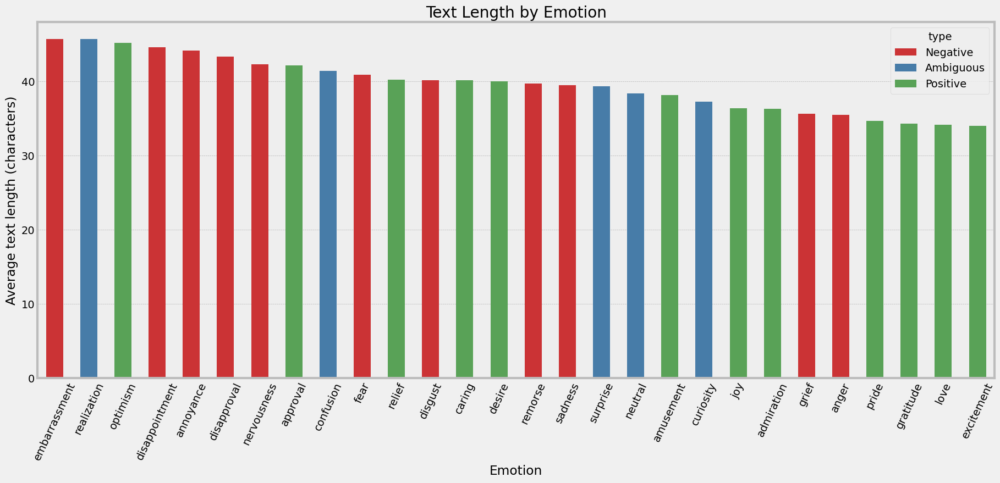

In [184]:
plt.figure(figsize = (20,8))
sns.barplot(data = avg_length_per_emotion.sort_values(by='text_length', ascending=False),
x = 'emotion',y ='text_length', hue = 'type',palette = 'Set1', dodge = False, width = 0.5)
          
plt.title('Text Length by Emotion')
plt.ylabel('Average text length (characters)')
plt.xlabel('Emotion')
plt.xticks(rotation = 65)
plt.show()

Hard to see correlation between type of emotion and length of text

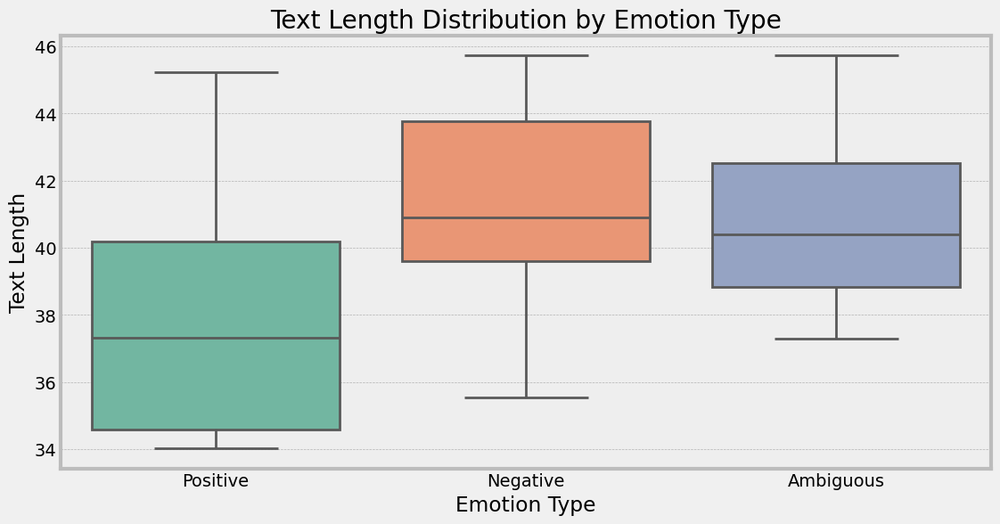

In [157]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='type', y='text_length', data=avg_length_per_emotion, palette ='Set2')
plt.title('Text Length Distribution by Emotion Type')
plt.xlabel('Emotion Type')
plt.ylabel('Text Length')
plt.show()


Shows texts labeled with negative emotions tend to be longer in length

In [189]:
#Create a dictionary where each type of emotion is a key and its value is the sum of all text labeled as this type
types = ['Positive','Negative','Ambiguous']
for t in types:
    type_text[t] = df_single_emotion[df_single_emotion['type'] == t ]['clean_text'].sum()

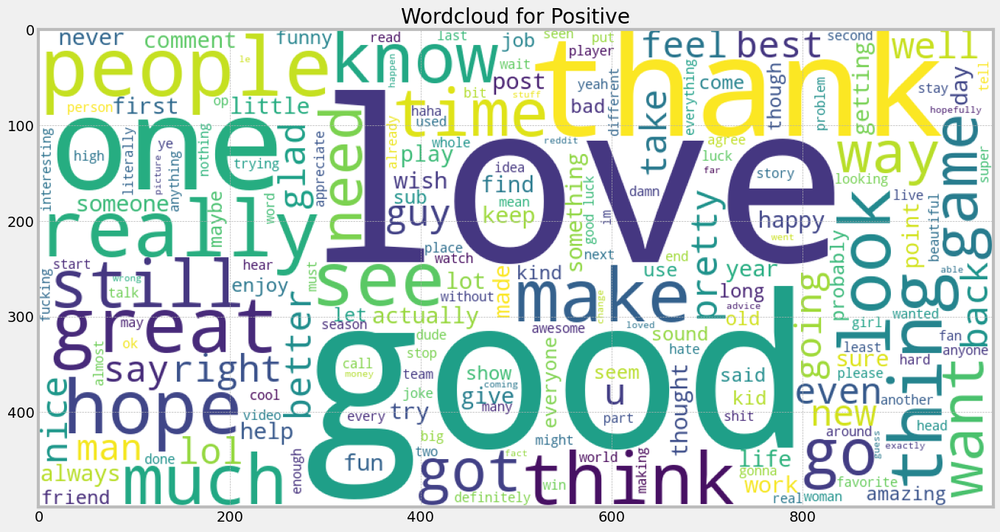

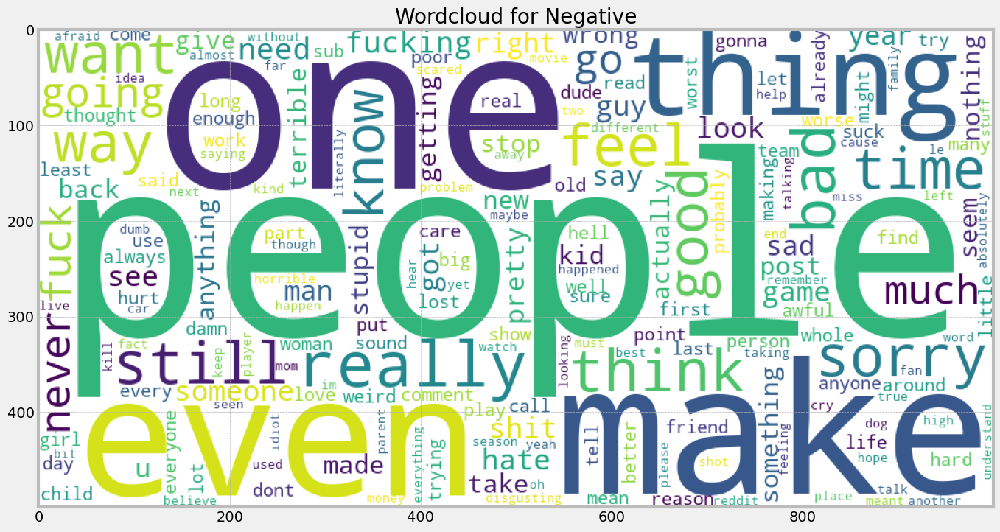

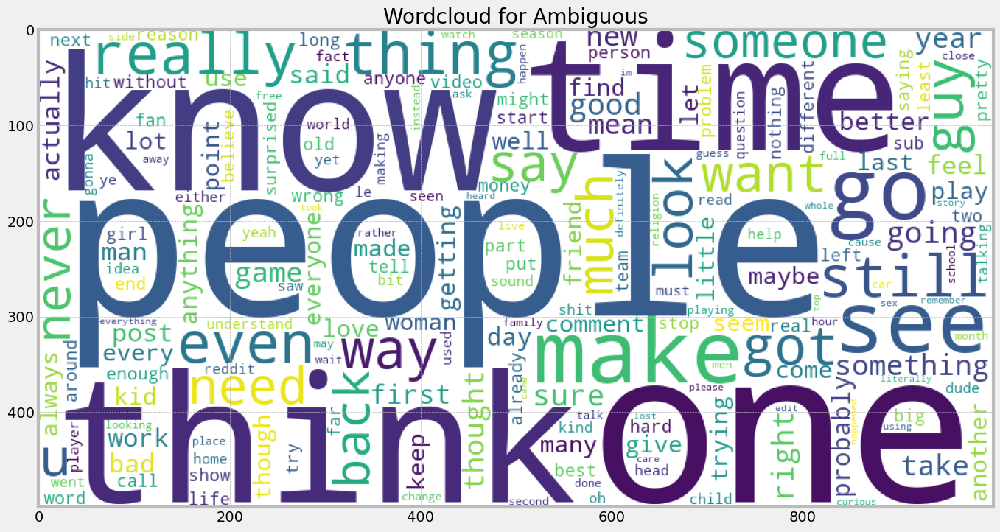

In [192]:
for t in type_text:
    wordcloud_maker(t,type_text[t])

Differences between word clouds but some popular, generic words (people, one, make etc.) are masking further identifying words. 